!pip3 install plotly
!pip3 install nbformat
!pip install -q catboost 
!pip install -q lightgbm
!pip install seaborn

In [3]:
import pandas as pd
import numpy as np
from datetime import datetime 

#plot
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go
from mpl_toolkits.mplot3d import Axes3D
import seaborn as sns
%matplotlib inline

#modle
import time
import lightgbm as lgb
import xgboost as xgb
from catboost import CatBoostClassifier
from sklearn import metrics
from sklearn.model_selection import StratifiedKFold
from sklearn.metrics import f1_score,accuracy_score
from sklearn.metrics import precision_score, recall_score, confusion_matrix, classification_report
from sklearn.metrics import matthews_corrcoef,cohen_kappa_score,balanced_accuracy_score

In [4]:
#load the data
data= pd.read_csv("2010to2017nsWithoutNA.csv")
#data = data[100000:]

In [5]:
data

,time,Longitude,Latitude,botDepth,date,depth,temperature,salinity,qualityflag
0,15.0,9.65706,53.57080,12.0,20100121.0,3.0,0.0005,33.658676,0.0
1,15.0,9.65226,53.57170,11.0,20100121.0,3.0,0.0026,33.658894,0.0
2,15.0,9.64802,53.57256,13.0,20100121.0,3.0,0.0015,33.658823,0.0
3,15.0,9.64354,53.57392,12.0,20100121.0,3.0,0.0018,33.658896,0.0
4,15.0,9.63918,53.57548,13.0,20100121.0,3.0,0.0010,33.658877,0.0
...,...,...,...,...,...,...,...,...,...
220607,7.0,355.97763,49.09174,0.0,20150111.0,3.5,14.0350,35.358181,0.0
220608,7.0,355.97485,49.09552,0.0,20150111.0,3.5,14.0310,35.358089,0.0
220609,7.0,355.97018,49.10169,0.0,20150111.0,3.5,14.0280,35.356300,0.0
220610,7.0,355.96609,49.10715,0.0,20150111.0,3.5,14.0340,35.356022,0.0


In [6]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 220612 entries, 0 to 220611
Data columns (total 9 columns):
 #   Column       Non-Null Count   Dtype  
---  ------       --------------   -----  
 0   time         220612 non-null  float64
 1   Longitude    220612 non-null  float64
 2   Latitude     220612 non-null  float64
 3   botDepth     220612 non-null  float64
 4   date         220612 non-null  float64
 5   depth        220612 non-null  float64
 6   temperature  220612 non-null  float64
 7   salinity     220612 non-null  float64
 8   qualityflag  220612 non-null  float64
dtypes: float64(9)
memory usage: 15.1 MB


## Drop time

In [7]:
data['qualityflag']=data['qualityflag'].round(0).astype("int")
data

,time,Longitude,Latitude,botDepth,date,depth,temperature,salinity,qualityflag
0,15.0,9.65706,53.57080,12.0,20100121.0,3.0,0.0005,33.658676,0
1,15.0,9.65226,53.57170,11.0,20100121.0,3.0,0.0026,33.658894,0
2,15.0,9.64802,53.57256,13.0,20100121.0,3.0,0.0015,33.658823,0
3,15.0,9.64354,53.57392,12.0,20100121.0,3.0,0.0018,33.658896,0
4,15.0,9.63918,53.57548,13.0,20100121.0,3.0,0.0010,33.658877,0
...,...,...,...,...,...,...,...,...,...
220607,7.0,355.97763,49.09174,0.0,20150111.0,3.5,14.0350,35.358181,0
220608,7.0,355.97485,49.09552,0.0,20150111.0,3.5,14.0310,35.358089,0
220609,7.0,355.97018,49.10169,0.0,20150111.0,3.5,14.0280,35.356300,0
220610,7.0,355.96609,49.10715,0.0,20150111.0,3.5,14.0340,35.356022,0


In [8]:
data = data.drop(['time', 'date'], axis=1)

In [9]:
cols = ['Longitude','Latitude','botDepth','depth','temperature','salinity','qualityflag']
data = data.reindex(columns=cols)
data.to_csv('data1.csv', index=False)

In [10]:
instance = data[(data['qualityflag']==1)]
rate=len(instance)/len(data)*100
print(rate)

0.6948851377078309


In [11]:
def plotCluster(data,name1,name2,name3,label,start,end):
    %matplotlib notebook

    data1=data.loc[data[label] == 1]
    #print(data1)

    x1 = data1.loc[:,[name1]].iloc[start:end, :]  # [ 0  3  6  9 12 15 18 21]
    y1 = data1.loc[:,[name2]].iloc[start:end, :]  # [ 1  4  7 10 13 16 19 22]
    z1 = data1.loc[:,[name3]].iloc[start:end, :]  # [ 2  5  8 11 14 17 20 23]


    data2=data.loc[data[label] == 0]
    #print(data2)

    x2 = data2.loc[:,[name1]].iloc[start:end, :]  # [ 0  3  6  9 12 15 18 21]
    y2 = data2.loc[:,[name2]].iloc[start:end, :]  # [ 1  4  7 10 13 16 19 22]
    z2 = data2.loc[:,[name3]].iloc[start:end, :]  # [ 2  5  8 11 14 17 20 23]

    fig = plt.figure()
    ax = fig.add_subplot(projection="3d")
    #ax = Axes3D(fig)
    ax.scatter(x1, y1, z1, c='r',s=10, label='Abnormal Data')
    ax.scatter(x2, y2, z2, c='g',s=10, label='Normal Data')
    
    ax.legend(loc='best')

    ax.set_zlabel(name1, fontdict={'size': 15, 'color': 'black'})
    ax.set_ylabel(name2, fontdict={'size': 15, 'color': 'black'})
    ax.set_xlabel(name3, fontdict={'size': 15, 'color': 'black'})
    plt.show()
    plt.savefig('scatter.png')
    
    #violin
    fig = px.violin(data, y=name1,color=label)
    fig.show()
    fig = px.violin(data, y=name2,color=label)
    fig.show()
    fig = px.violin(data, y=name3,color=label)
    fig.show()
    


<IPython.core.display.Javascript object>


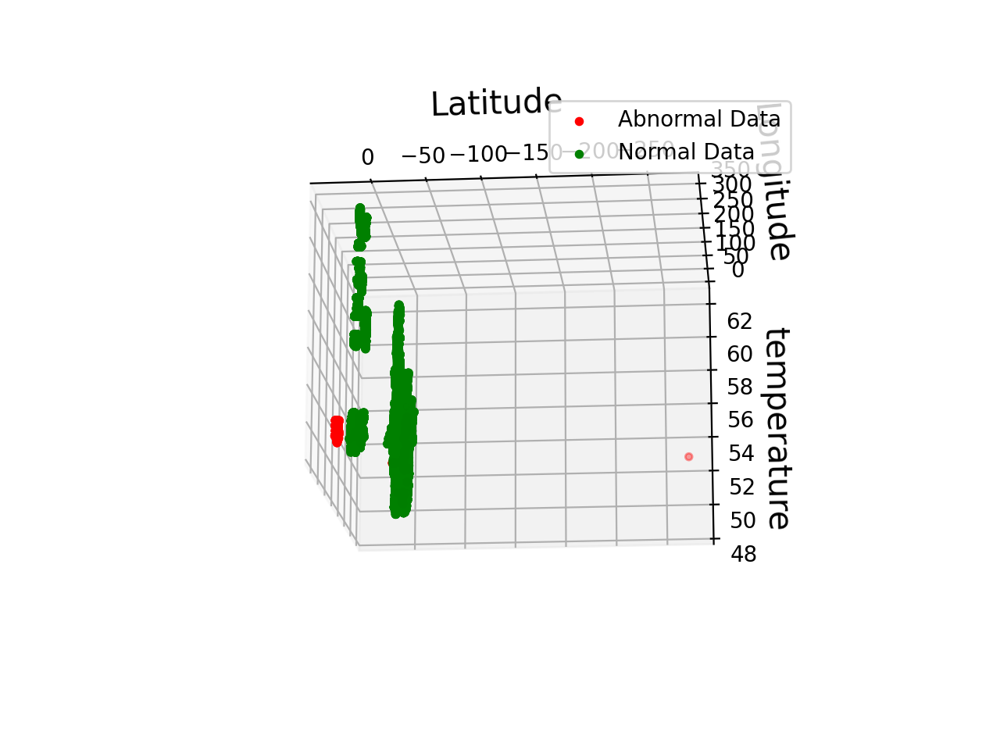

In [12]:
dataplot=data.copy()
#dataplot['qualityflag']=y
#plot 3D figure by any three features

plotCluster(dataplot,'temperature','pressure','sality','qualityflag',0,data.shape[0])

## test set
### random 10%  
test1
### and  last 10%
test2

In [11]:
#split the data and make sure the proportion in train and test set are equal
def getRandomSplit(data, size):
    from sklearn.model_selection import StratifiedShuffleSplit
    from sklearn.model_selection import train_test_split
    train_set, test_set = train_test_split(data, test_size = size,random_state = 42)
#    split = StratifiedShuffleSplit(n_splits = 1,test_size = size,random_state = 42)

#     for train_index,test_index in split.split(data,data.iloc[:,-1]):
#         train_set = data.iloc[train_index,:]
#         test_set = data.iloc[test_index,:]

    print(len(train_set),len(test_set))
    return train_set,test_set
    

In [14]:
#split the last 10% data 

# window
def sliding_window(data, window_size):
    # from last raw
    for i in range(len(data)-1, window_size-2, -1):
        data_slice = data[i-window_size+1:i+1]
        ratio = (data_slice["qualityflag"] == 1).sum() / window_size*100
        #print(ratio)
        if 0.65 <= ratio <= 0.75:
            #print(data_slice)
            return data_slice



def getLastSplit(data, size):
    row,col=data.shape
    window_size = int(size*row)
    test_set=sliding_window(data, window_size)
    index=test_set.index[0]
    train_set=data.head(index-1)
    print(len(train_set),len(test_set))
    return train_set,test_set
# windows keep the same rate of anomaly

In [16]:
#sampling
train_set1,test_set1 = getRandomSplit(data,0.1)
train_set2,test_set2 = getLastSplit(data,0.1)

198550 22062
182405 22061


In [17]:
train_set1 = train_set1.sample(n=182405)
#print(train_set1.shape)

In [18]:
train_set1.head()
test_set1.head()

,Longitude,Latitude,botDepth,depth,temperature,salinity,qualityflag
160562,6.31966,53.99097,0.0,3.5,4.9540,33.244011,0
157176,359.24570,50.21590,0.0,3.5,10.1950,35.299110,0
76575,358.82507,59.00033,121.0,1.0,14.4874,34.961880,0
158237,1.99344,52.20330,0.0,3.5,5.7200,34.115299,0
197913,1.50011,50.55151,0.0,3.5,8.7440,34.289879,0


In [19]:
instance = test_set1[(test_set1['qualityflag']==1)]
rate=len(instance)/len(test_set1)*100
print(rate)

0.6255099265705739


In [20]:
print(test_set2)

        Longitude  Latitude  botDepth  depth  temperature   salinity  \
182406    3.51698  55.18972       0.0    3.5        6.084  34.768101   
182407    3.52086  55.18604       0.0    3.5        6.084  34.764198   
182408    3.52661  55.18059       0.0    3.5        6.086  34.863258   
182409    3.52998  55.17726       0.0    3.5        6.086  34.868568   
182410    3.53365  55.17385       0.0    3.5        6.089  34.775002   
...           ...       ...       ...    ...          ...        ...   
204462    5.79364  54.86416       0.0    3.5        6.922  34.448811   
204463    5.79898  54.86565       0.0    3.5        6.924  34.446510   
204464    5.80420  54.86711       0.0    3.5        6.926  34.444809   
204465    5.81020  54.86880       0.0    3.5        6.932  34.441910   
204466    5.81236  54.87219       0.0    3.5        6.944  34.441010   

        qualityflag  
182406            1  
182407            1  
182408            0  
182409            0  
182410            1  
...

In [21]:
print(train_set2)

        Longitude  Latitude  botDepth  depth  temperature   salinity  \
0         9.65706  53.57080      12.0    3.0       0.0005  33.658676   
1         9.65226  53.57170      11.0    3.0       0.0026  33.658894   
2         9.64802  53.57256      13.0    3.0       0.0015  33.658823   
3         9.64354  53.57392      12.0    3.0       0.0018  33.658896   
4         9.63918  53.57548      13.0    3.0       0.0010  33.658877   
...           ...       ...       ...    ...          ...        ...   
182400    3.48923  55.21585       0.0    3.5       6.0980  34.864689   
182401    3.49391  55.21149       0.0    3.5       6.0950  34.877102   
182402    3.49991  55.20596       0.0    3.5       6.0910  34.863010   
182403    3.50586  55.20042       0.0    3.5       6.0880  34.786701   
182404    3.50923  55.19718       0.0    3.5       6.0850  34.861832   

        qualityflag  
0                 0  
1                 0  
2                 0  
3                 0  
4                 0  
...

In [22]:
instance = test_set2[(test_set2['qualityflag']==1)]
rate=len(instance)/len(test_set2)*100
print(rate)

0.6527355967544535


## supervised ml

In [25]:
params = {'num_leaves': 60, 
          'min_data_in_leaf': 30,
          'objective': 'binary', 
          'max_depth': -1,
          'learning_rate': 0.03,
          "min_sum_hessian_in_leaf": 6,
          "boosting": "gbdt",
          "feature_fraction": 0.9,
          "bagging_freq": 1,
          "bagging_fraction": 0.8,
          "bagging_seed": 11,
          "verbosity": -1,
          "random_state": 2019,
          }




In [26]:
lgb_params = {
    'boosting_type': 'gbdt',
    'objective': 'binary',
    'n_estimators': 100000,
    'learning_rate': 0.1,
    'random_state': 2948,
    'bagging_freq': 8,
    'bagging_fraction': 0.80718,
    'feature_fraction': 0.7,  # 0.3
    'feature_fraction_seed': 11,
    'max_depth': 9,
    'min_data_in_leaf': 40,
    'min_child_weight': 0.18654,
    "min_split_gain": 0.35079,
    'min_sum_hessian_in_leaf': 1.11347,
    'num_leaves': 29,
    'num_threads': 4,
    "lambda_l1": 0.55831,
    'lambda_l2': 1.67906,
    'cat_smooth': 10.4,
    'subsample': 0.7,
    'colsample_bytree': 0.7,
    'n_jobs': -1,
    'metric': 'auc'
}

In [24]:
# metric
def computeMetric(y_tru,y_pre):
    acc = accuracy_score(y_tru,y_pre)
    pre=precision_score(y_tru,y_pre)
    recall=recall_score(y_tru,y_pre)
    cm=confusion_matrix(y_tru,y_pre)
    f1 = f1_score(y_tru,y_pre)
    mcc=matthews_corrcoef(y_tru, y_pre)
    kappa=cohen_kappa_score(y_tru, y_pre)
    bac=balanced_accuracy_score(y_tru,y_pre)
    print("acc:",acc)
    print("balanced acc:",bac)
    print("precision:",pre)
    print("recall:",recall)
    print("cm:",cm)
    print("f1:",f1)
    print("MCC:", mcc)
    print("Kappa:",kappa)
    
    
    # confusion matrix
    cmap1 = sns.diverging_palette(260,-10,s=50, l=75, n=5, as_cmap=True)
    plt.subplots(figsize=(12,8))
    cf_matrix = confusion_matrix(y_tru, y_pre)
    sns.heatmap(cf_matrix/np.sum(cf_matrix), cmap = cmap1, annot = True, annot_kws = {'size':15})

In [25]:
#this function use random grid search to find best parameters
def getPar(model,dist,data,niter):
    import numpy as np
    import pandas as pd
    from sklearn.model_selection import RandomizedSearchCV
    x,y=data.shape

    clf1 = model

    param_dist = dist
    grid = RandomizedSearchCV(clf1,param_dist,cv = 3,scoring = "balanced_accuracy",n_iter=niter,n_jobs = -1)

    #train
    grid.fit(data.iloc[:,0:y-1],data.iloc[:,y-1])
    #get best parameter
    print(grid.best_score_)
    return grid.best_params_

In [26]:
def classSuper(train_set,test_set):
    x,y=data.shape
    score=[]
    models=[]
    # fit model and predict
    
    
    ##lightgbm
    print("lightgbm")
    clf1 = lgb.LGBMClassifier()
    clf1 = clf1.fit(train_set.iloc[:,0:y-1],train_set.iloc[:,y-1])
    y_pre1=clf1.predict(test_set.iloc[:,0:y-1])
    y_tru1=test_set.iloc[:,y-1]
    computeMetric(y_tru1,y_pre1)
    
    
    
    
    ## GradientBoosting
    print("GradientBoosting")
    from sklearn.ensemble import GradientBoostingClassifier
    clf2 = GradientBoostingClassifier()
    clf2.fit(train_set.iloc[:,0:y-1],train_set.iloc[:,y-1])
    y_pre2 = clf2.predict(test_set.iloc[:,0:y-1])
    computeMetric(y_tru1,y_pre2)
    
    ##catboost
    print("catboost")
    clf3 = CatBoostClassifier(loss_function='Logloss')
    clf3.fit(train_set.iloc[:,0:y-1],train_set.iloc[:,y-1])
    y_pre3 = clf3.predict(test_set.iloc[:,0:y-1])
    computeMetric(y_tru1,y_pre3)

    
    
    
    #KNN
    print("KNN")
    from sklearn.neighbors import KNeighborsClassifier
    clf4 = KNeighborsClassifier()
    dic4={'n_neighbors':[1,2,3,4,5,6,7,8,9]}
    #para11=getPar(clf11,dic11,p_set,10)
    clf4 = KNeighborsClassifier(n_jobs=-1)
    clf4.fit(train_set.iloc[:,0:y-1],train_set.iloc[:,y-1])

    y_pre4=clf4.predict(test_set.iloc[:,0:y-1])
    computeMetric(y_tru1,y_pre4)
    
#     #MLP
#     print("MLP")
#     from sklearn.neural_network import MLPClassifier
#     clf5 = MLPClassifier(solver='lbfgs', alpha=1e-5,hidden_layer_sizes=(5, 2), random_state=1)
#     clf5.fit(train_set.iloc[:,0:y-1],train_set.iloc[:,y-1])
#     y_pre5 = clf5.predict(test_set.iloc[:,0:y-1])
#     computeMetric(y_tru1,y_pre5)
   



## random

lightgbm
acc: 0.9992747710996284
balanced acc: 0.9636312795982961
precision: 0.9552238805970149
recall: 0.927536231884058
cm: [[21918     6]
 [   10   128]]
f1: 0.9411764705882353
MCC: 0.9409147002882714
Kappa: 0.9408116863518381
GradientBoosting
acc: 0.9979602937177047
balanced acc: 0.8657595805271967
precision: 0.926605504587156
recall: 0.7318840579710145
cm: [[21916     8]
 [   37   101]]
f1: 0.8178137651821862
MCC: 0.8225550225737305
Kappa: 0.8168023870549875
catboost
Learning rate set to 0.095147
0:	learn: 0.4300816	total: 79.7ms	remaining: 1m 19s
1:	learn: 0.2483154	total: 101ms	remaining: 50.4s
2:	learn: 0.1564539	total: 118ms	remaining: 39.2s
3:	learn: 0.1027210	total: 135ms	remaining: 33.5s
4:	learn: 0.0697667	total: 151ms	remaining: 30.1s
5:	learn: 0.0509429	total: 166ms	remaining: 27.4s
6:	learn: 0.0391698	total: 181ms	remaining: 25.6s
7:	learn: 0.0315042	total: 197ms	remaining: 24.4s
8:	learn: 0.0267437	total: 211ms	remaining: 23.3s
9:	learn: 0.0228562	total: 225ms	remainin

161:	learn: 0.0041054	total: 2.57s	remaining: 13.3s
162:	learn: 0.0040832	total: 2.59s	remaining: 13.3s
163:	learn: 0.0040652	total: 2.6s	remaining: 13.3s
164:	learn: 0.0040456	total: 2.62s	remaining: 13.3s
165:	learn: 0.0040344	total: 2.64s	remaining: 13.3s
166:	learn: 0.0040124	total: 2.66s	remaining: 13.3s
167:	learn: 0.0039928	total: 2.67s	remaining: 13.2s
168:	learn: 0.0039775	total: 2.69s	remaining: 13.2s
169:	learn: 0.0039642	total: 2.7s	remaining: 13.2s
170:	learn: 0.0039526	total: 2.72s	remaining: 13.2s
171:	learn: 0.0039294	total: 2.73s	remaining: 13.2s
172:	learn: 0.0039094	total: 2.75s	remaining: 13.1s
173:	learn: 0.0038909	total: 2.76s	remaining: 13.1s
174:	learn: 0.0038706	total: 2.78s	remaining: 13.1s
175:	learn: 0.0038504	total: 2.79s	remaining: 13.1s
176:	learn: 0.0038377	total: 2.81s	remaining: 13.1s
177:	learn: 0.0038220	total: 2.82s	remaining: 13s
178:	learn: 0.0038094	total: 2.84s	remaining: 13s
179:	learn: 0.0037914	total: 2.85s	remaining: 13s
180:	learn: 0.003781

332:	learn: 0.0020846	total: 5.05s	remaining: 10.1s
333:	learn: 0.0020826	total: 5.07s	remaining: 10.1s
334:	learn: 0.0020808	total: 5.08s	remaining: 10.1s
335:	learn: 0.0020777	total: 5.09s	remaining: 10.1s
336:	learn: 0.0020766	total: 5.11s	remaining: 10s
337:	learn: 0.0020730	total: 5.12s	remaining: 10s
338:	learn: 0.0020632	total: 5.13s	remaining: 10s
339:	learn: 0.0020611	total: 5.15s	remaining: 9.99s
340:	learn: 0.0020582	total: 5.16s	remaining: 9.97s
341:	learn: 0.0020486	total: 5.17s	remaining: 9.96s
342:	learn: 0.0020456	total: 5.19s	remaining: 9.94s
343:	learn: 0.0020441	total: 5.2s	remaining: 9.92s
344:	learn: 0.0020430	total: 5.21s	remaining: 9.89s
345:	learn: 0.0020403	total: 5.23s	remaining: 9.88s
346:	learn: 0.0020354	total: 5.24s	remaining: 9.86s
347:	learn: 0.0020253	total: 5.26s	remaining: 9.85s
348:	learn: 0.0020214	total: 5.27s	remaining: 9.83s
349:	learn: 0.0020181	total: 5.29s	remaining: 9.81s
350:	learn: 0.0020138	total: 5.3s	remaining: 9.8s
351:	learn: 0.0020116

491:	learn: 0.0014222	total: 7.3s	remaining: 7.54s
492:	learn: 0.0014205	total: 7.32s	remaining: 7.53s
493:	learn: 0.0014165	total: 7.34s	remaining: 7.51s
494:	learn: 0.0014160	total: 7.35s	remaining: 7.5s
495:	learn: 0.0014157	total: 7.36s	remaining: 7.48s
496:	learn: 0.0014147	total: 7.38s	remaining: 7.47s
497:	learn: 0.0014086	total: 7.39s	remaining: 7.45s
498:	learn: 0.0014056	total: 7.41s	remaining: 7.44s
499:	learn: 0.0014052	total: 7.42s	remaining: 7.42s
500:	learn: 0.0014048	total: 7.43s	remaining: 7.41s
501:	learn: 0.0014015	total: 7.45s	remaining: 7.39s
502:	learn: 0.0013984	total: 7.46s	remaining: 7.37s
503:	learn: 0.0013956	total: 7.48s	remaining: 7.36s
504:	learn: 0.0013926	total: 7.49s	remaining: 7.34s
505:	learn: 0.0013913	total: 7.5s	remaining: 7.32s
506:	learn: 0.0013816	total: 7.52s	remaining: 7.31s
507:	learn: 0.0013806	total: 7.53s	remaining: 7.29s
508:	learn: 0.0013773	total: 7.55s	remaining: 7.28s
509:	learn: 0.0013761	total: 7.56s	remaining: 7.26s
510:	learn: 0.0

651:	learn: 0.0010773	total: 9.57s	remaining: 5.11s
652:	learn: 0.0010750	total: 9.58s	remaining: 5.09s
653:	learn: 0.0010734	total: 9.6s	remaining: 5.08s
654:	learn: 0.0010727	total: 9.61s	remaining: 5.06s
655:	learn: 0.0010717	total: 9.63s	remaining: 5.05s
656:	learn: 0.0010709	total: 9.64s	remaining: 5.03s
657:	learn: 0.0010703	total: 9.65s	remaining: 5.02s
658:	learn: 0.0010675	total: 9.67s	remaining: 5s
659:	learn: 0.0010662	total: 9.68s	remaining: 4.99s
660:	learn: 0.0010633	total: 9.7s	remaining: 4.97s
661:	learn: 0.0010580	total: 9.71s	remaining: 4.96s
662:	learn: 0.0010545	total: 9.72s	remaining: 4.94s
663:	learn: 0.0010531	total: 9.74s	remaining: 4.93s
664:	learn: 0.0010514	total: 9.75s	remaining: 4.91s
665:	learn: 0.0010504	total: 9.77s	remaining: 4.9s
666:	learn: 0.0010475	total: 9.78s	remaining: 4.88s
667:	learn: 0.0010459	total: 9.79s	remaining: 4.87s
668:	learn: 0.0010454	total: 9.81s	remaining: 4.85s
669:	learn: 0.0010447	total: 9.82s	remaining: 4.84s
670:	learn: 0.0010

818:	learn: 0.0008489	total: 11.9s	remaining: 2.63s
819:	learn: 0.0008483	total: 11.9s	remaining: 2.61s
820:	learn: 0.0008482	total: 11.9s	remaining: 2.6s
821:	learn: 0.0008467	total: 11.9s	remaining: 2.58s
822:	learn: 0.0008452	total: 11.9s	remaining: 2.57s
823:	learn: 0.0008425	total: 12s	remaining: 2.55s
824:	learn: 0.0008421	total: 12s	remaining: 2.54s
825:	learn: 0.0008421	total: 12s	remaining: 2.52s
826:	learn: 0.0008417	total: 12s	remaining: 2.51s
827:	learn: 0.0008408	total: 12s	remaining: 2.49s
828:	learn: 0.0008400	total: 12s	remaining: 2.48s
829:	learn: 0.0008389	total: 12s	remaining: 2.46s
830:	learn: 0.0008388	total: 12s	remaining: 2.45s
831:	learn: 0.0008383	total: 12s	remaining: 2.43s
832:	learn: 0.0008379	total: 12.1s	remaining: 2.42s
833:	learn: 0.0008366	total: 12.1s	remaining: 2.4s
834:	learn: 0.0008357	total: 12.1s	remaining: 2.39s
835:	learn: 0.0008343	total: 12.1s	remaining: 2.37s
836:	learn: 0.0008335	total: 12.1s	remaining: 2.36s
837:	learn: 0.0008332	total: 12.

986:	learn: 0.0007322	total: 14.1s	remaining: 186ms
987:	learn: 0.0007322	total: 14.2s	remaining: 172ms
988:	learn: 0.0007322	total: 14.2s	remaining: 158ms
989:	learn: 0.0007322	total: 14.2s	remaining: 143ms
990:	learn: 0.0007322	total: 14.2s	remaining: 129ms
991:	learn: 0.0007322	total: 14.2s	remaining: 114ms
992:	learn: 0.0007322	total: 14.2s	remaining: 100ms
993:	learn: 0.0007322	total: 14.2s	remaining: 85.8ms
994:	learn: 0.0007322	total: 14.2s	remaining: 71.5ms
995:	learn: 0.0007322	total: 14.2s	remaining: 57.2ms
996:	learn: 0.0007322	total: 14.3s	remaining: 42.9ms
997:	learn: 0.0007322	total: 14.3s	remaining: 28.6ms
998:	learn: 0.0007322	total: 14.3s	remaining: 14.3ms
999:	learn: 0.0007321	total: 14.3s	remaining: 0us
acc: 0.9992747710996284
balanced acc: 0.9420289855072463
precision: 1.0
recall: 0.8840579710144928
cm: [[21924     0]
 [   16   122]]
f1: 0.9384615384615386
MCC: 0.9399006657429666
Kappa: 0.9380981641568673
KNN
acc: 0.9995014051309945
balanced acc: 0.9637453098847402


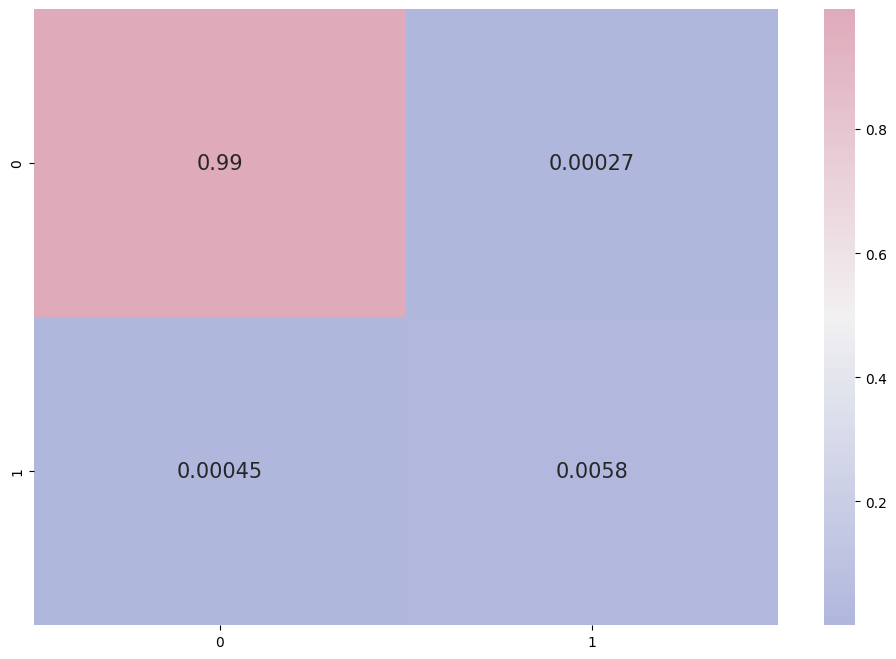

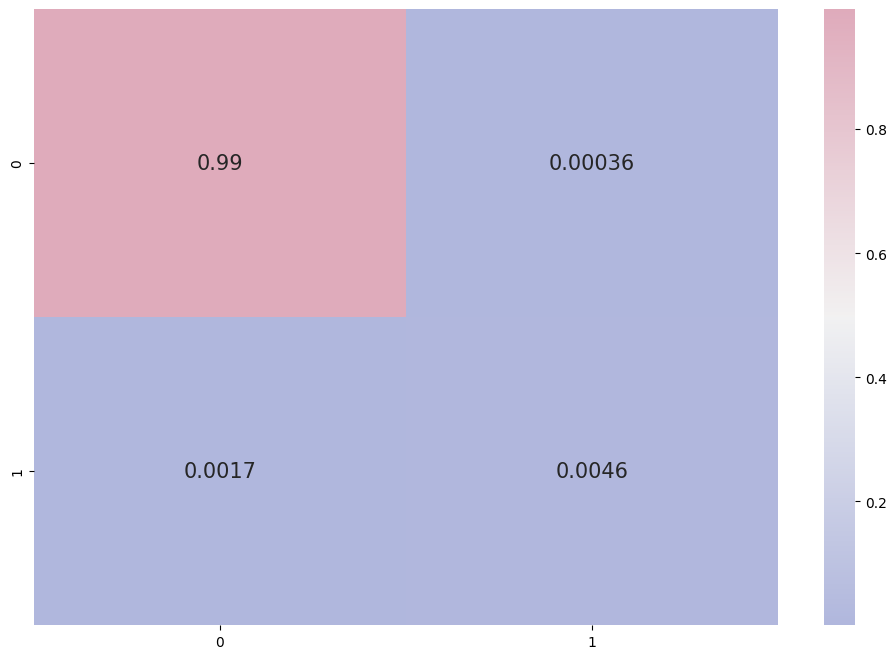

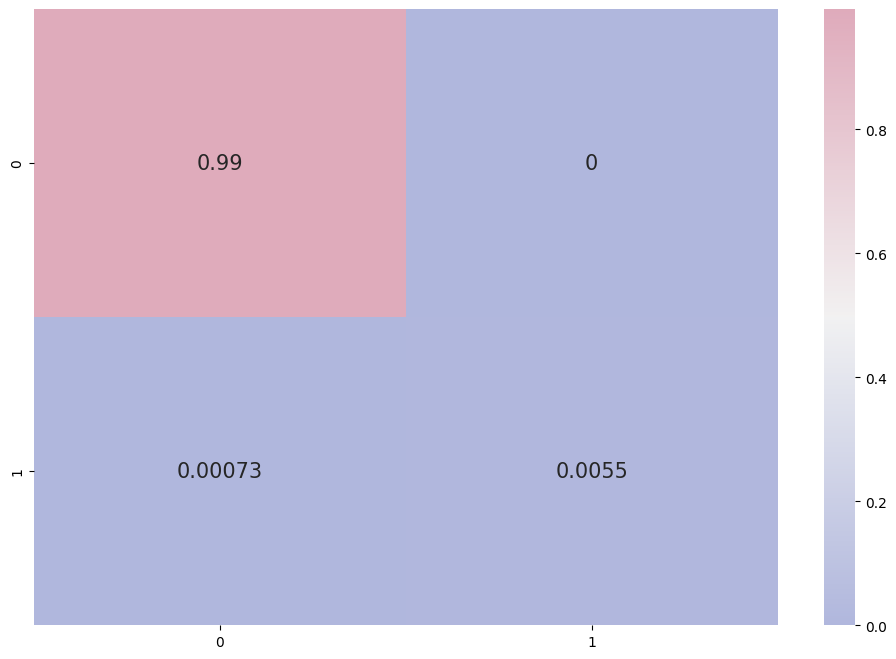

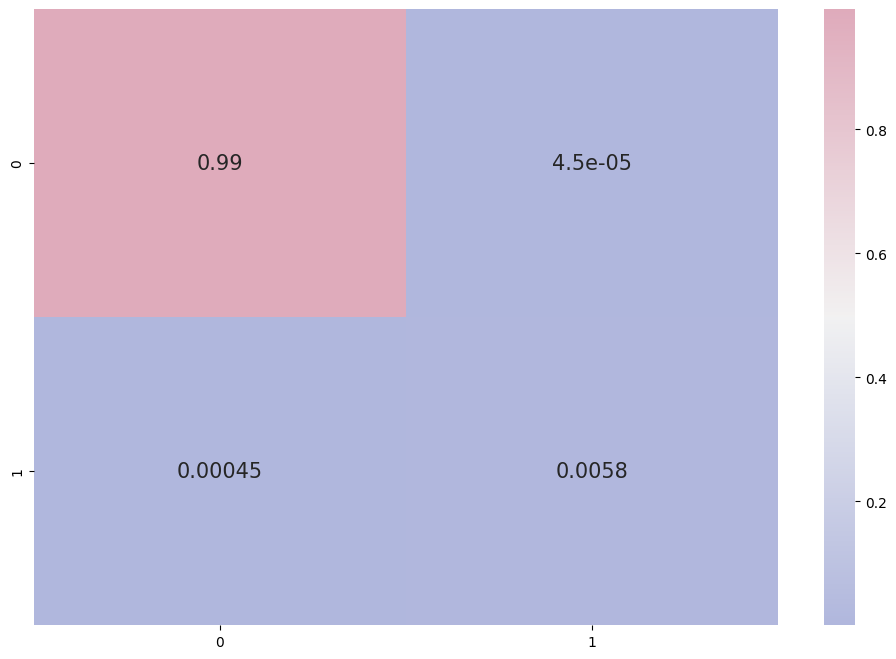

In [27]:
#random
classSuper(train_set1,test_set1)

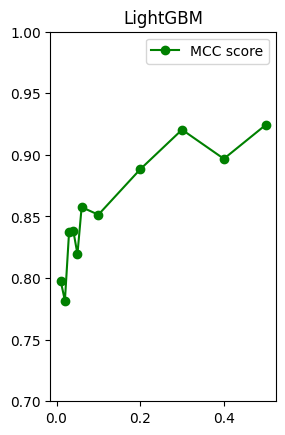

In [28]:
#learning curve
model = lgb.LGBMClassifier()
title1 = "LightGBM"
plt.subplot(121)
x,y=train_set1.shape
train_sizes=[0.01,0.02,0.03,0.04,0.05,0.06,0.1,0.2,0.3,0.4,0.5,]
mccList=[]
plt.title(title1)
ylim=[0.7,1.0]
if ylim is not None:
    plt.ylim(*ylim)
for size in train_sizes:
    train_set = train_set1.sample(frac=size)
    clf = model.fit(train_set.iloc[:,0:y-1],train_set.iloc[:,y-1])
    y_pre=clf.predict(test_set1.iloc[:,0:y-1])
    y_tru=test_set1.iloc[:,y-1]
    #compute metric
    mcc=matthews_corrcoef(y_tru, y_pre)
    mccList.append(mcc)
        

plt.plot(train_sizes, mccList, "o-", color="green", label="MCC score")
plt.legend(loc="best")
plt.show()

## Last

error reason: some predict label type do not exist in training set.

In [29]:
print(train_set2)
print(test_set2)

        Longitude  Latitude  botDepth  depth  temperature   salinity  \
0         9.65706  53.57080      12.0    3.0       0.0005  33.658676   
1         9.65226  53.57170      11.0    3.0       0.0026  33.658894   
2         9.64802  53.57256      13.0    3.0       0.0015  33.658823   
3         9.64354  53.57392      12.0    3.0       0.0018  33.658896   
4         9.63918  53.57548      13.0    3.0       0.0010  33.658877   
...           ...       ...       ...    ...          ...        ...   
182400    3.48923  55.21585       0.0    3.5       6.0980  34.864689   
182401    3.49391  55.21149       0.0    3.5       6.0950  34.877102   
182402    3.49991  55.20596       0.0    3.5       6.0910  34.863010   
182403    3.50586  55.20042       0.0    3.5       6.0880  34.786701   
182404    3.50923  55.19718       0.0    3.5       6.0850  34.861832   

        qualityflag  
0                 0  
1                 0  
2                 0  
3                 0  
4                 0  
...

lightgbm
acc: 0.9780608313313086
balanced acc: 0.49569287285871444
precision: 0.0029239766081871343
recall: 0.006944444444444444
cm: [[21576   341]
 [  143     1]]
f1: 0.00411522633744856
MCC: -0.005615087414454297
Kappa: -0.005118444152628854
GradientBoosting
acc: 0.9927473822582839
balanced acc: 0.49963498654012867
precision: 0.0
recall: 0.0
cm: [[21901    16]
 [  144     0]]
f1: 0.0
MCC: -0.0021837133642695315
Kappa: -0.0013071776763102783
catboost
Learning rate set to 0.095147
0:	learn: 0.4126657	total: 13.5ms	remaining: 13.5s
1:	learn: 0.2348452	total: 26.3ms	remaining: 13.1s
2:	learn: 0.1390437	total: 43.2ms	remaining: 14.4s
3:	learn: 0.0891548	total: 56.1ms	remaining: 14s
4:	learn: 0.0599562	total: 69.1ms	remaining: 13.8s
5:	learn: 0.0429308	total: 82.6ms	remaining: 13.7s
6:	learn: 0.0324219	total: 96.5ms	remaining: 13.7s
7:	learn: 0.0252776	total: 109ms	remaining: 13.5s
8:	learn: 0.0208089	total: 122ms	remaining: 13.4s
9:	learn: 0.0181622	total: 134ms	remaining: 13.3s
10:	learn

164:	learn: 0.0028245	total: 2.15s	remaining: 10.9s
165:	learn: 0.0028186	total: 2.16s	remaining: 10.8s
166:	learn: 0.0028087	total: 2.17s	remaining: 10.8s
167:	learn: 0.0028031	total: 2.19s	remaining: 10.8s
168:	learn: 0.0027885	total: 2.2s	remaining: 10.8s
169:	learn: 0.0027803	total: 2.21s	remaining: 10.8s
170:	learn: 0.0027719	total: 2.22s	remaining: 10.8s
171:	learn: 0.0027588	total: 2.24s	remaining: 10.8s
172:	learn: 0.0027503	total: 2.25s	remaining: 10.8s
173:	learn: 0.0027497	total: 2.26s	remaining: 10.7s
174:	learn: 0.0027388	total: 2.27s	remaining: 10.7s
175:	learn: 0.0027334	total: 2.29s	remaining: 10.7s
176:	learn: 0.0027127	total: 2.3s	remaining: 10.7s
177:	learn: 0.0026993	total: 2.31s	remaining: 10.7s
178:	learn: 0.0026953	total: 2.33s	remaining: 10.7s
179:	learn: 0.0026663	total: 2.34s	remaining: 10.7s
180:	learn: 0.0026515	total: 2.35s	remaining: 10.6s
181:	learn: 0.0026411	total: 2.37s	remaining: 10.6s
182:	learn: 0.0026357	total: 2.38s	remaining: 10.6s
183:	learn: 0.

330:	learn: 0.0015561	total: 4.21s	remaining: 8.52s
331:	learn: 0.0015550	total: 4.23s	remaining: 8.5s
332:	learn: 0.0015545	total: 4.24s	remaining: 8.49s
333:	learn: 0.0015524	total: 4.25s	remaining: 8.47s
334:	learn: 0.0015491	total: 4.26s	remaining: 8.46s
335:	learn: 0.0015451	total: 4.27s	remaining: 8.45s
336:	learn: 0.0015428	total: 4.29s	remaining: 8.43s
337:	learn: 0.0015410	total: 4.3s	remaining: 8.42s
338:	learn: 0.0015343	total: 4.31s	remaining: 8.4s
339:	learn: 0.0015223	total: 4.32s	remaining: 8.39s
340:	learn: 0.0015215	total: 4.33s	remaining: 8.37s
341:	learn: 0.0015212	total: 4.34s	remaining: 8.36s
342:	learn: 0.0015193	total: 4.35s	remaining: 8.34s
343:	learn: 0.0015159	total: 4.37s	remaining: 8.33s
344:	learn: 0.0015140	total: 4.38s	remaining: 8.31s
345:	learn: 0.0015055	total: 4.39s	remaining: 8.3s
346:	learn: 0.0015035	total: 4.4s	remaining: 8.28s
347:	learn: 0.0015014	total: 4.41s	remaining: 8.27s
348:	learn: 0.0014994	total: 4.43s	remaining: 8.26s
349:	learn: 0.001

498:	learn: 0.0010178	total: 6.26s	remaining: 6.28s
499:	learn: 0.0010159	total: 6.27s	remaining: 6.27s
500:	learn: 0.0010146	total: 6.28s	remaining: 6.26s
501:	learn: 0.0010140	total: 6.3s	remaining: 6.25s
502:	learn: 0.0010096	total: 6.31s	remaining: 6.23s
503:	learn: 0.0010085	total: 6.32s	remaining: 6.22s
504:	learn: 0.0010080	total: 6.33s	remaining: 6.21s
505:	learn: 0.0010068	total: 6.34s	remaining: 6.19s
506:	learn: 0.0010060	total: 6.36s	remaining: 6.18s
507:	learn: 0.0010023	total: 6.37s	remaining: 6.17s
508:	learn: 0.0010018	total: 6.38s	remaining: 6.16s
509:	learn: 0.0010007	total: 6.39s	remaining: 6.14s
510:	learn: 0.0009984	total: 6.41s	remaining: 6.13s
511:	learn: 0.0009984	total: 6.42s	remaining: 6.12s
512:	learn: 0.0009984	total: 6.43s	remaining: 6.1s
513:	learn: 0.0009984	total: 6.44s	remaining: 6.09s
514:	learn: 0.0009984	total: 6.45s	remaining: 6.08s
515:	learn: 0.0009984	total: 6.46s	remaining: 6.06s
516:	learn: 0.0009984	total: 6.48s	remaining: 6.05s
517:	learn: 0.

657:	learn: 0.0008608	total: 8.09s	remaining: 4.21s
658:	learn: 0.0008599	total: 8.1s	remaining: 4.19s
659:	learn: 0.0008594	total: 8.12s	remaining: 4.18s
660:	learn: 0.0008588	total: 8.13s	remaining: 4.17s
661:	learn: 0.0008585	total: 8.14s	remaining: 4.16s
662:	learn: 0.0008577	total: 8.15s	remaining: 4.14s
663:	learn: 0.0008572	total: 8.16s	remaining: 4.13s
664:	learn: 0.0008572	total: 8.17s	remaining: 4.12s
665:	learn: 0.0008565	total: 8.19s	remaining: 4.11s
666:	learn: 0.0008557	total: 8.2s	remaining: 4.09s
667:	learn: 0.0008538	total: 8.21s	remaining: 4.08s
668:	learn: 0.0008530	total: 8.22s	remaining: 4.07s
669:	learn: 0.0008523	total: 8.24s	remaining: 4.06s
670:	learn: 0.0008518	total: 8.25s	remaining: 4.04s
671:	learn: 0.0008517	total: 8.26s	remaining: 4.03s
672:	learn: 0.0008505	total: 8.27s	remaining: 4.02s
673:	learn: 0.0008456	total: 8.28s	remaining: 4.01s
674:	learn: 0.0008438	total: 8.3s	remaining: 3.99s
675:	learn: 0.0008416	total: 8.31s	remaining: 3.98s
676:	learn: 0.0

831:	learn: 0.0008146	total: 9.93s	remaining: 2s
832:	learn: 0.0008146	total: 9.94s	remaining: 1.99s
833:	learn: 0.0008146	total: 9.95s	remaining: 1.98s
834:	learn: 0.0008146	total: 9.96s	remaining: 1.97s
835:	learn: 0.0008146	total: 9.97s	remaining: 1.96s
836:	learn: 0.0008146	total: 9.98s	remaining: 1.94s
837:	learn: 0.0008146	total: 9.99s	remaining: 1.93s
838:	learn: 0.0008146	total: 10s	remaining: 1.92s
839:	learn: 0.0008146	total: 10s	remaining: 1.91s
840:	learn: 0.0008146	total: 10s	remaining: 1.89s
841:	learn: 0.0008146	total: 10s	remaining: 1.88s
842:	learn: 0.0008146	total: 10s	remaining: 1.87s
843:	learn: 0.0008146	total: 10.1s	remaining: 1.86s
844:	learn: 0.0008146	total: 10.1s	remaining: 1.84s
845:	learn: 0.0008146	total: 10.1s	remaining: 1.83s
846:	learn: 0.0008146	total: 10.1s	remaining: 1.82s
847:	learn: 0.0008146	total: 10.1s	remaining: 1.81s
848:	learn: 0.0008146	total: 10.1s	remaining: 1.8s
849:	learn: 0.0008146	total: 10.1s	remaining: 1.78s
850:	learn: 0.0008146	tota

991:	learn: 0.0008146	total: 11.6s	remaining: 93.3ms
992:	learn: 0.0008146	total: 11.6s	remaining: 81.6ms
993:	learn: 0.0008146	total: 11.6s	remaining: 70ms
994:	learn: 0.0008146	total: 11.6s	remaining: 58.3ms
995:	learn: 0.0008146	total: 11.6s	remaining: 46.6ms
996:	learn: 0.0008146	total: 11.6s	remaining: 35ms
997:	learn: 0.0008145	total: 11.6s	remaining: 23.3ms
998:	learn: 0.0008145	total: 11.7s	remaining: 11.7ms
999:	learn: 0.0008145	total: 11.7s	remaining: 0us
acc: 0.6858709940619192
balanced acc: 0.345188666332071
precision: 0.0
recall: 0.0
cm: [[15131  6786]
 [  144     0]]
f1: 0.0
MCC: -0.05402652200501467
Kappa: -0.012948977740843581
KNN
acc: 0.9902996237704547
balanced acc: 0.5294477460418853
precision: 0.10227272727272728
recall: 0.0625
cm: [[21838    79]
 [  135     9]]
f1: 0.07758620689655171
MCC: 0.07524330107742866
Kappa: 0.07299587967973664


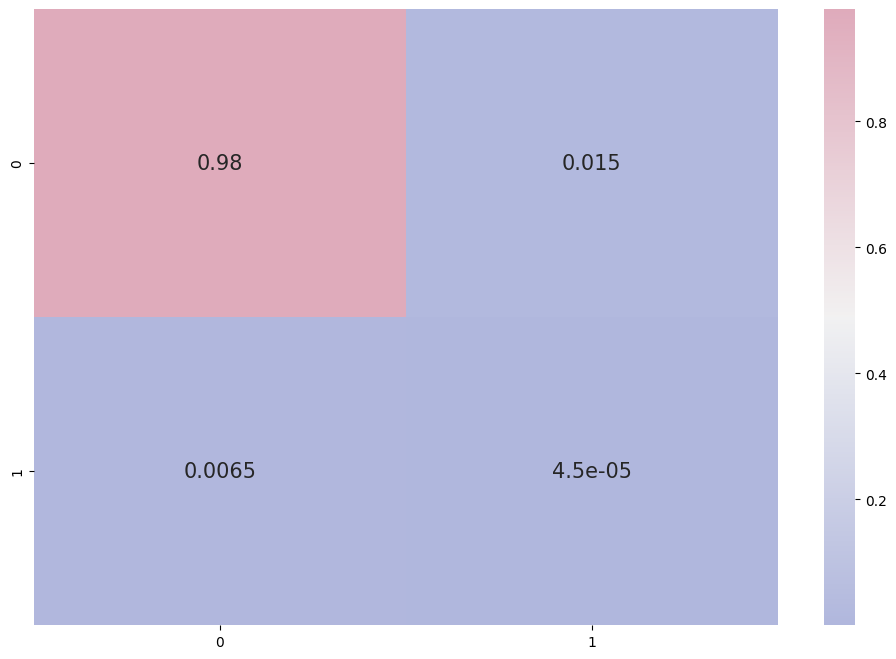

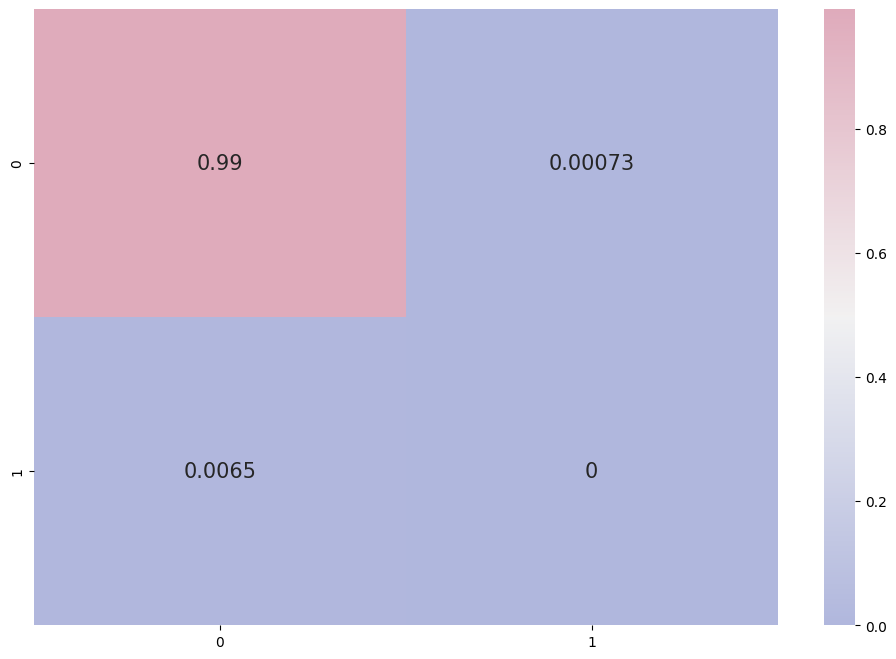

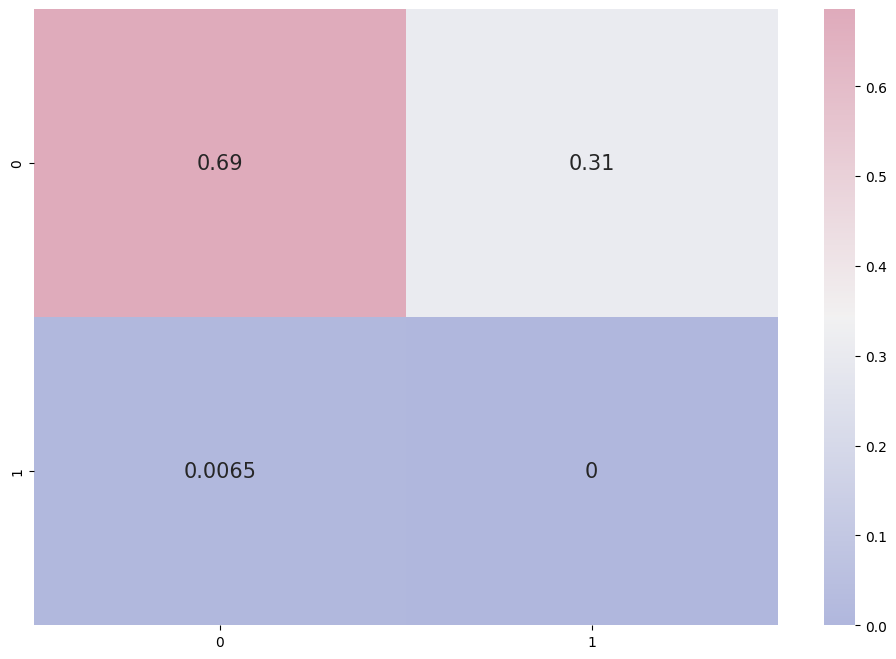

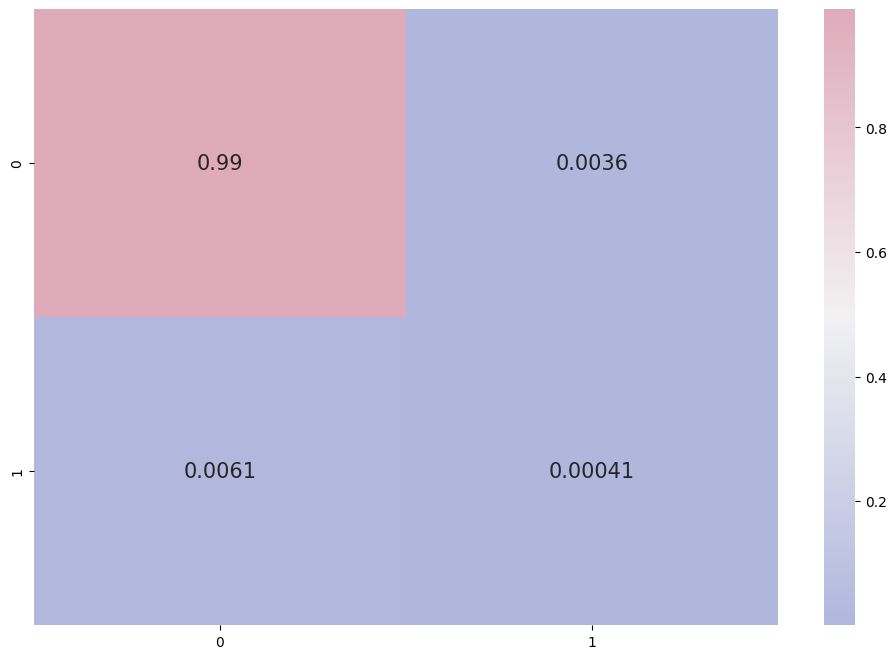

In [32]:
#last
classSuper(train_set2,test_set2)

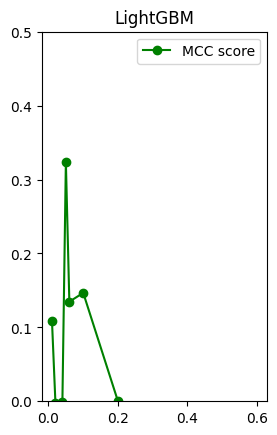

In [31]:
#learning curve
model = lgb.LGBMClassifier()
title1 = "LightGBM"
plt.subplot(121)
x,y=train_set2.shape
train_sizes=[0.01,0.02,0.03,0.04,0.05,0.06,0.1,0.2,0.25,0.6]
mccList=[]
plt.title(title1)
ylim=[0.0,0.5]
if ylim is not None:
    plt.ylim(*ylim)
for size in train_sizes:
    row=int(size*x)
    train_set  = train_set2[-row:]
    clf = model.fit(train_set.iloc[:,0:y-1],train_set.iloc[:,y-1])
    y_pre=clf.predict(test_set2.iloc[:,0:y-1])
    y_tru=test_set2.iloc[:,y-1]
    #compute metric
    mcc=matthews_corrcoef(y_tru, y_pre)
    mccList.append(mcc)
        

plt.plot(train_sizes, mccList, "o-", color="green", label="MCC score")
plt.legend(loc="best")
plt.show()